#  Notebook 2 - Correlation and RMT
### Hugo C Marrochio
### Date: Nov 1 2024

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px

from scipy.optimize import minimize
from sklearn.neighbors import KernelDensity

import seaborn as sns
import plotly.graph_objects as go
import random
plt.rcParams['figure.figsize'] = (8.0, 6.0) #setting figure size

## Summary of Correlation and RMT - Notebook 2

In this notebook, I will continue the EDA about S&P500 data from kaggle (https://www.kaggle.com/datasets/andrewmvd/sp-500-stocks). The goal of this notebook is to focus on analysing correlation matrices and their spectrum of eigenvalues.

The main goal of this project is to investigate clustering between stocks, and to apply Random Matrix Theory techniques for regularizaiton. Therefore, correlation matrices really are the basic objects of interest for this project. 

There are a few plotting functions that I separated into an auxiliary notebook for clarity.



### Notebook 2

#### 0 - Loading Auxiliary Functions and csv Files

    - Load the data we produced in Notebook 1.
    - Import auxiliary functions.

#### Part 1 - Correlation Matrices

    - Analyze correlation matrices for top 30 companies. 
    - Show an animation over 5 year period of time, longer periods are more stable but could be eliminating some transient real signal between stocks
    - Repeat analysis of correlation matrices for random 30 companies. 
    - Repeat the animation over 5 years. It seems companies randomly selected has overall a bit smaller values of correlation.

#### Part 2 - Eigenvalues and RMT
     - Analyze the spectrum of eigenvalues for the correlation matrices. We consider 100 companies as we need more data to be able to compare to RMT. 
    - The low-lying eigenvalues definitely concentrate in a range for smaller values. It indicates random behavior.
    - Fit the free paramaters of the Marcenko-Pastur pdf in order to characterize the random range.

#### Appendix
    - In the appendix, I just briefly produce a plot of the eigenvalue stastistics of computer generated random matrices to show agreement with the MP pdf theoretical prediction of large N. 


## 0 - Loading auxliary functions and .csv files

For clarity I wrote the auxiliary functions in a separate notebook, then used terminal to convert it to a .py script 

In [2]:
from auxiliary_functions import *

In [3]:
#Set random seed, define a function so we don't need to recall later in the notebook
#def set_global_seed(seed=10):
#    '''
#    Set a global seed value for the notebook. If seed=10, you can just run set_global_seed()
#    '''
#    random.seed(seed)
#    np.random.seed(seed)

# Call the function to set seed value for the whole notebook
#set_global_seed()

In [4]:
print(np.random.rand(2))

[0.07288004 0.57852461]


Let us load the relevant dataframe from EDA - Part 1

In [5]:
df_top_100=pd.read_csv('data/sp500_stocks_top_100.csv')
df_top_60=pd.read_csv('data/sp500_stocks_top_60.csv')
df_top_30=pd.read_csv('data/sp500_stocks_top_30.csv')
df_random_100=pd.read_csv('data/sp500_stocks_random_100.csv')
df_random_60=pd.read_csv('data/sp500_stocks_random_60.csv')
df_random_30=pd.read_csv('data/sp500_stocks_random_30.csv')

In [6]:
#Transform the date column into datetime object
df_top_100['Date']=pd.to_datetime(df_top_100['Date'])
df_top_60['Date']=pd.to_datetime(df_top_60['Date'])
df_top_30['Date']=pd.to_datetime(df_top_30['Date'])
df_random_100['Date']=pd.to_datetime(df_random_100['Date'])
df_random_60['Date']=pd.to_datetime(df_random_60['Date'])
df_random_30['Date']=pd.to_datetime(df_random_30['Date'])

## Part 1 - Correlation Matrices

Let us create a filter for 5 years data, between 2015 and 2019

In [7]:
condition_5y=(df_top_30['Date']>'2015-01-01')&(df_top_30['Date']<'2019-12-31')
df_top_30_5y=df_top_30[condition_5y]

Next, we want to change the DataFrame such that the index stock is a column, and the rows are simply the values of `Return`. This particular format is useful as we can simply truncate the rows at a certain window value range in order to calculate the correlation for different periods!

In [8]:
grouped_top_30_5y= df_top_30_5y.groupby('Symbol')['Return'].apply(list).reset_index()
values_top_30_5y = pd.DataFrame(grouped_top_30_5y['Return'].tolist(), index=grouped_top_30_5y['Symbol']).T
# Subtract the mean and divide by the standard deviation 
values_top_30_5y=(values_top_30_5y-values_top_30_5y.mean())/values_top_30_5y.std()
correlation_matrix_top_30_5y=values_top_30_5y.corr()

We can see that __correlation_matrix_top_30_5y__ calculates the correlation matrix using all the data between 2015-2019

In [9]:
correlation_matrix_top_30_5y

Symbol,AAPL,ABBV,AMZN,AVGO,BAC,BRK-B,COST,CRM,CVX,GOOG,...,NFLX,NVDA,ORCL,PG,TMUS,TSLA,UNH,V,WMT,XOM
Symbol,,,,,,,,,,,,,,,,,,,,,
AAPL,1.000000,0.266315,0.492670,0.532791,0.399859,0.472334,0.353793,0.458649,0.327439,0.521497,...,0.366767,0.429664,0.435744,0.267179,0.285998,0.298137,0.351168,0.531898,0.233616,0.362949
ABBV,0.266315,1.000000,0.277632,0.239567,0.287710,0.350252,0.201617,0.301281,0.277453,0.335182,...,0.229537,0.230457,0.315991,0.215831,0.239573,0.180098,0.349961,0.327720,0.189577,0.301769
AMZN,0.492670,0.277632,1.000000,0.350180,0.339643,0.376858,0.329035,0.501320,0.275881,0.640978,...,0.482049,0.397010,0.359803,0.211859,0.335142,0.311459,0.332843,0.552547,0.189913,0.292750
AVGO,0.532791,0.239567,0.350180,1.000000,0.373017,0.404342,0.245799,0.420763,0.285430,0.386170,...,0.309373,0.454360,0.387600,0.224954,0.283395,0.300540,0.271129,0.432626,0.195314,0.290303
BAC,0.399859,0.287710,0.339643,0.373017,1.000000,0.681857,0.294111,0.375470,0.451587,0.393654,...,0.307823,0.350400,0.443963,0.207944,0.316863,0.252708,0.378867,0.483896,0.212127,0.464750
BRK-B,0.472334,0.350252,0.376858,0.404342,0.681857,1.000000,0.442836,0.411200,0.531076,0.460124,...,0.310489,0.358562,0.514335,0.404224,0.353502,0.243800,0.447342,0.556648,0.370240,0.560380
COST,0.353793,0.201617,0.329035,0.245799,0.294111,0.442836,1.000000,0.282589,0.298828,0.350710,...,0.245937,0.253439,0.295357,0.342611,0.245882,0.179311,0.298059,0.385933,0.470722,0.309283
CRM,0.458649,0.301281,0.501320,0.420763,0.375470,0.411200,0.282589,1.000000,0.284988,0.485640,...,0.418881,0.431582,0.448518,0.226327,0.385695,0.325794,0.336405,0.611114,0.196368,0.290863
CVX,0.327439,0.277453,0.275881,0.285430,0.451587,0.531076,0.298828,0.284988,1.000000,0.302326,...,0.231621,0.254144,0.398311,0.300132,0.217567,0.209162,0.299350,0.379905,0.234270,0.772329


In [10]:
fig = px.imshow(correlation_matrix_top_30_5y, width=800, height=800,color_continuous_scale='RdBu', zmin=-1, zmax=1,title='Heatmap Correlation 5 years, Top 30 stocks')
#fig.write_image('figures/top30_heatmap.png')
fig.show()

Can we make animations to investigate the effect of changing the time window for calculating the correlation matrix? I follwed some of the examples of plotly in order to reproduce a video of the heatmap by varying the date.

#### Heatmap animation - Top 30 companies

We can simply call the auxilary function we defined to animate the heatmap, for each frame it increases in 15 trading days used for calculating the correlation between the variables.

In [11]:
fig1=plot_heatmap_animation(df_top_30_5y,'Correlation matrix top 30 stocks S&P, 2015-2019')
fig1.show()

In [12]:
fig1.write_html("correlation_heatmap_top30.html")

### Random 30 companies

We can repeat a similar analysis for random 30 companies

In [13]:
condition_5y=(df_random_30['Date']>'2015-01-01')&(df_random_30['Date']<'2019-12-31')
df_random_30_5y=df_random_30[condition_5y]

Similarly, we reshape the DataFrame in order to calculate the correlation

In [14]:
grouped_random_30_5y= df_random_30_5y.groupby('Symbol')['Return'].apply(list).reset_index()
values_random_30_5y = pd.DataFrame(grouped_random_30_5y['Return'].tolist(), index=grouped_random_30_5y['Symbol']).T
values_random_30_5y=(values_random_30_5y-values_random_30_5y.mean())/values_random_30_5y.std()
correlation_matrix_random_30_5y=values_random_30_5y.corr()

In [15]:
fig = px.imshow(correlation_matrix_random_30_5y, width=800, height=800,color_continuous_scale='RdBu', zmin=-1, zmax=1, title='Heatmap Correlation 5 years, Random 30 stocks')
fig.show()

We can already see that by simply selecting at random 30 companies, the correlation is a bit less strong. It makes sense, most of the top companies are also in the same sector, so there might be extra correlation due to that.

For completeness, let us also animate the correlation matrix for 15 day interval

In [16]:
fig2=plot_heatmap_animation(df_random_30_5y,'Correlation matrix random 30 stocks S&P, 2015-2019')
fig2.show()

In [17]:
fig2.write_html("correlation_heatmap_random30.html")

## Part 2 - Eigenvalues and RMT

Ok, we can finally ask ourselves about the eigenvalues of the correlation matrices. Let us look into the top 100 stocks first. It is important to increase the amount of data if we want to compare with RMT large matrix limit.

In [18]:
condition_5y=(df_top_100['Date']>'2015-01-01')&(df_top_100['Date']<'2019-12-31')
df_top_100_5y=df_top_100[condition_5y]

We can calculate the correlation function as before

In [19]:
grouped_top_100_5y= df_top_100_5y.groupby('Symbol')['Return'].apply(list).reset_index()
values_top_100_5y = pd.DataFrame(grouped_top_100_5y['Return'].tolist(), index=grouped_top_100_5y['Symbol']).T
values_top_100_5y=(values_top_100_5y-values_top_100_5y.mean())/values_top_100_5y.std()
correlation_matrix_top_100_5y=values_top_100_5y.corr()

In [20]:
fig3 = px.imshow(correlation_matrix_top_100_5y, width=800, height=800,color_continuous_scale='RdBu', zmin=-1, zmax=1,title='Heatmap Correlation 5 years, Top 100 stocks')
fig3.show()

What about the eigenvalue structure?

In [21]:
eig_list_top_100_5y=np.linalg.eigvals(correlation_matrix_top_100_5y)

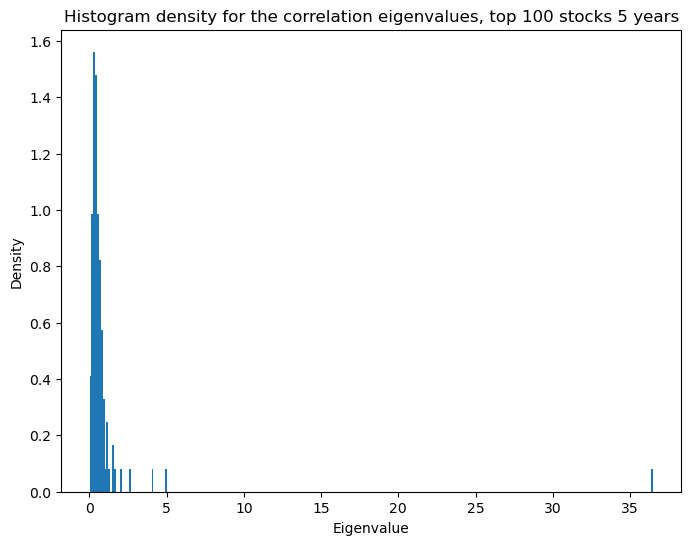

In [22]:
plt.hist(eig_list_top_100_5y,bins=300,density=True)
#plt.xlim([0,6])
plt.title('Histogram density for the correlation eigenvalues, top 100 stocks 5 years')
plt.xlabel('Eigenvalue')
plt.ylabel('Density')
plt.show()

This large eigenvalue is always there, is called the market component. In future analysis, we will see how to deal with that gap in a process called _'detoning'_.

It is intructive to focus on the left hand side of the plot

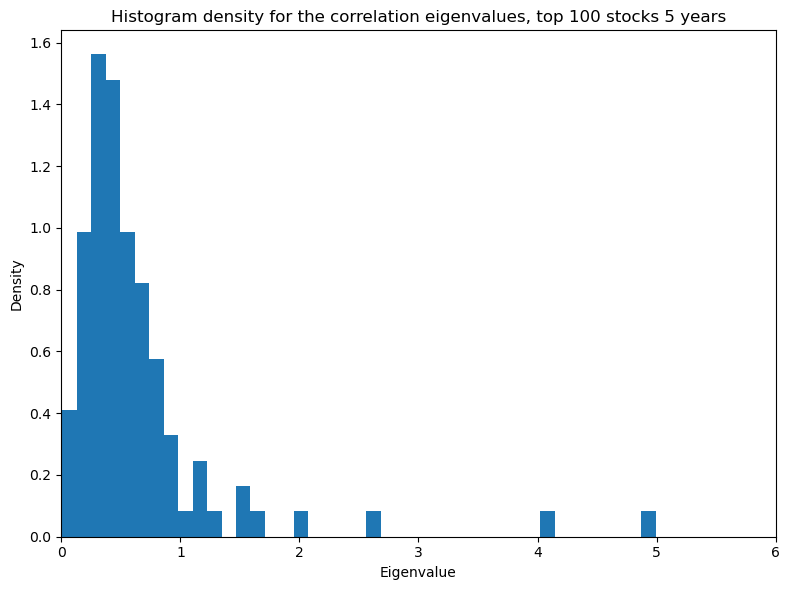

In [23]:
plt.hist(eig_list_top_100_5y,bins=300,density=True)
plt.xlim([0,6])
plt.title('Histogram density for the correlation eigenvalues, top 100 stocks 5 years')
plt.xlabel('Eigenvalue')
plt.ylabel('Density')
plt.tight_layout()
plt.savefig('figures/Hist_Top_Eig.png')
plt.show()

There is a large concentration of eigenvalues towards the origin of the plot. This accumulation is due to properties analous to random matrix statistics. 

In fact, if the correlation matrix was completely due to randomness, in the large matrix limit we would expect that this histogram density to follow the Marcenko-Pastur (MP) pdf. 

The MP pdf is completely characterized by __two__ parameters: $\sigma$ (related to the standard deviation of observations) and $q$ (related to the ratio of observations to factors and $q>1$). The pdf is given by

$f(\lambda) = \frac{q}{2 \pi \lambda \sigma^2}  \sqrt{(\lambda_+-\lambda)(\lambda-\lambda_-)} \qquad \lambda \in [ \lambda_{-},\lambda_{+} ]$
and 0 otherwise.

The paramaters $\lambda_{\pm}$ indicate the maximum and minimum eigenvalues, and they are also completely described by $q$ and $\sigma$ as

$\lambda_{\pm} = \sigma^2 \left( 1\pm \sqrt{\frac{1}{q}}\right)$ .

Since our data has finite size effects, as well other small correlations that are not completely due to randomness, we will consider both $\sigma$ and $q$ to be free parameters, one that we will determine via a minimization with respect to the histogram density of our data. The method involves Kernel Density Estimation (KDE) and finding $\sigma$ and $q$ that minimize the difference sum squared between the theoretical prediction (MP pdf) and the KDE of our data.

We followed the book of _"Machine Learning for Asset Managers"_ by Lopez de Prado, modifying where necessary to fit our needs. 

In fact, let us comment that there are a few hyperparameters that would modify the prediction of our fit. For instance, the bandwidth associated with the KDE changes the format of the histogram itself. Therefore, there are other possible avenues for fitting the curve - for instance, in Lopez Prado book, he fixes q with information from the data, and only optimize for sigma. From my finidings overall, the message behind the fit remains the same: A large range of the smaller eigenvalues falls into the random range, and a few are actually related to signal. This is common to finance data, where signal is expected to be weak.

Let us estimate which range of eigenvalues are probably due to randomness. The optimizer __findMaxEval__ returns the scales maximum "random" eigenvalue $\lambda_+$, as well as the $\sigma$ and $q$ that minimizes the squared difference between data and theory.

In [24]:
#Delete the market eigenvalue
max_index = np.argmax(eig_list_top_100_5y)
eig_list_top_100_5y=np.delete(eig_list_top_100_5y, max_index)

In [25]:
eig_list_top_100_5y.max()

4.932039273147439

In [26]:
eMax0, sigma_opt0,q_opt0=findMaxEval(np.array(eig_list_top_100_5y),bWidth=0.1,flag = True)

SSE: 582.5641987841155
SSE: 582.5641424202607
SSE: 582.5641991078801
SSE: 66.7782599723348
SSE: 66.77825756101005
SSE: 66.7782599119954
SSE: 56.67172123185057
SSE: 56.6717261883269
SSE: 56.67172128976613
SSE: 48.571521626973066
SSE: 48.571521288877136
SSE: 48.571521612248965
SSE: 48.69559648822745
SSE: 48.69559825786727
SSE: 48.69559650559143
SSE: 47.81927608418402
SSE: 47.81927665204945
SSE: 47.819276083983524
SSE: 47.81914873451194
SSE: 47.81914931636895
SSE: 47.819148734525626
SSE: 47.81914813555197
SSE: 47.81914871651369
SSE: 47.81914813555196
Optimization result:   message: CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL
  success: True
   status: 0
      fun: 47.81914813555197
        x: [ 1.000e+00  1.296e+01]
      nit: 5
      jac: [-5.810e+01 -7.105e-07]
     nfev: 24
     njev: 8
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>


In [27]:
print(f'The optimal q is {q_opt0} and sigma is {sigma_opt0}')

The optimal q is 12.963842384322039 and sigma is 0.99999


In [28]:
y,x = f_MP_pdf_plot(q_opt0,sigma_opt0)

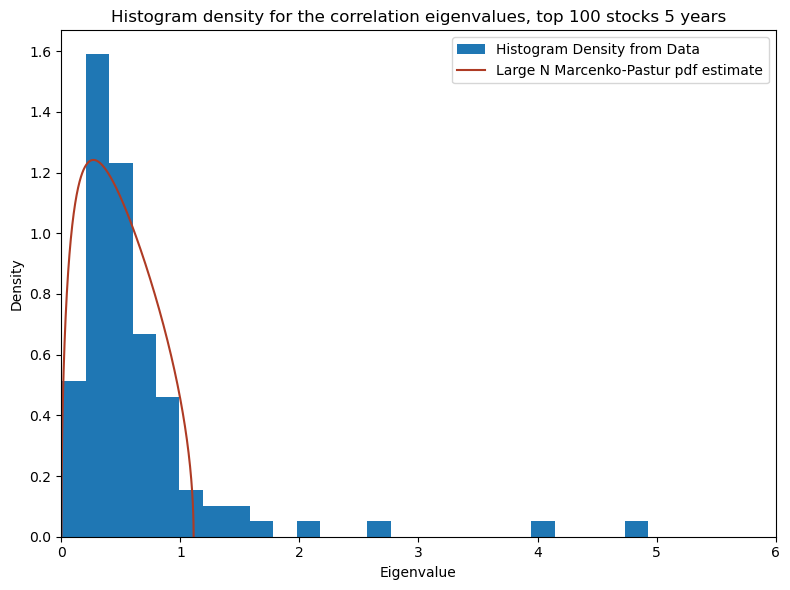

In [29]:
plt.hist(eig_list_top_100_5y,bins=25,density=True,label='Histogram Density from Data')
plt.plot(x,y,color='#AE3B24', label='Large N Marcenko-Pastur pdf estimate')
plt.xlim([0,6])
plt.title('Histogram density for the correlation eigenvalues, top 100 stocks 5 years')
plt.xlabel('Eigenvalue')
plt.ylabel('Density')
plt.tight_layout()
plt.savefig('figures/Hist_Top_Eig_RMT.png')
plt.legend()
plt.show()

As commented, there are definitely freedom with hyperparameters and range of data that need further analysis, but it does seem very clear that there is a range associated to randomness!

## Random 100 for 5 years

Let us repeat the analysis but for 100 stocks selected at random

In [30]:
condition_5y=(df_random_100['Date']>'2015-01-01')&(df_random_100['Date']<'2019-12-31')
df_random_100_5y=df_random_100[condition_5y]

In [31]:
grouped_random_100_5y= df_random_100_5y.groupby('Symbol')['Return'].apply(list).reset_index()
values_random_100_5y = pd.DataFrame(grouped_random_100_5y['Return'].tolist(), index=grouped_random_100_5y['Symbol']).T
values_random_100_5y=(values_random_100_5y-values_random_100_5y.mean())/values_random_100_5y.std()
correlation_matrix_random_100_5y=values_random_100_5y.corr()

In [32]:
fig4 = px.imshow(correlation_matrix_random_100_5y, width=800, height=800,color_continuous_scale='RdBu', zmin=-1, zmax=1,title='Heatmap Correlation 5 years, Random 100 stocks')
fig4.show()

Now let us evaluate a histogram of the eigenvalues!

In [33]:
eig_list_random_100_5y=np.linalg.eigvals(correlation_matrix_random_100_5y)

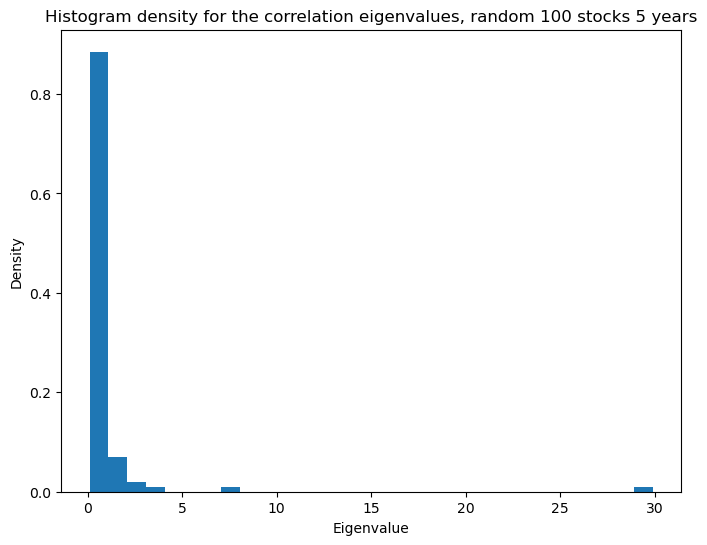

In [34]:
plt.hist(eig_list_random_100_5y,bins=30,density=True)
#plt.xlim([0,6])
plt.title('Histogram density for the correlation eigenvalues, random 100 stocks 5 years')
plt.xlabel('Eigenvalue')
plt.ylabel('Density')
#plt.tight_layout()
#plt.savefig('figures/Hist_Rnd_Eig.png')
plt.show()

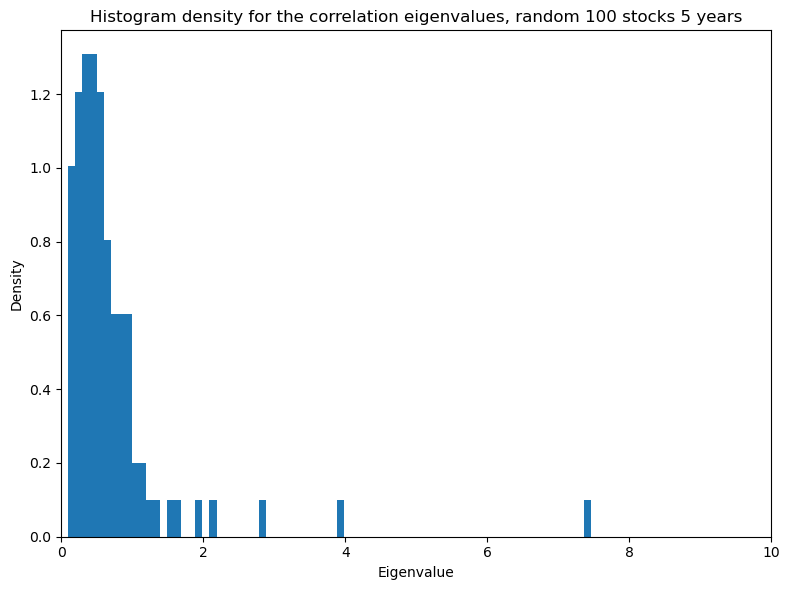

In [35]:
plt.hist(eig_list_random_100_5y,bins=300,density=True)
plt.xlim([0,10])
plt.title('Histogram density for the correlation eigenvalues, random 100 stocks 5 years')
plt.xlabel('Eigenvalue')
plt.ylabel('Density')
plt.tight_layout()
plt.savefig('figures/Hist_Rnd_Eig.png')
plt.show()

Great, can we repeat our analysis for fitting the MP distribution? We will again eliminate the largest market eigenvalue

In [36]:
#Delete the market eigenvalue
max_index = np.argmax(eig_list_random_100_5y)
eig_list_random_100_5y=np.delete(eig_list_random_100_5y, max_index)

In [37]:
eMax1, sigma_opt1,q_opt1=findMaxEval(np.array(eig_list_random_100_5y),bWidth=0.1,flag = True)

SSE: 704.2882010368813
SSE: 704.2881369388083
SSE: 704.2882014071541
SSE: 70.99715362759466
SSE: 70.9971524500067
SSE: 70.99715358267134
SSE: 41.13905804973695
SSE: 41.139059005581856
SSE: 41.13905805425266
SSE: 41.2548186170098
SSE: 41.25481890472905
SSE: 41.25481860884596
SSE: 41.08898834822302
SSE: 41.088989059457894
SSE: 41.08898834822283
SSE: 41.08898834814806
SSE: 41.08898905939317
SSE: 41.08898834814798
Optimization result:   message: CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL
  success: True
   status: 0
      fun: 41.08898834814806
        x: [ 1.000e+00  1.065e+01]
      nit: 4
      jac: [-7.112e+01 -7.816e-06]
     nfev: 18
     njev: 6
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>


In [38]:
y,x = f_MP_pdf_plot(q_opt1,sigma_opt1)

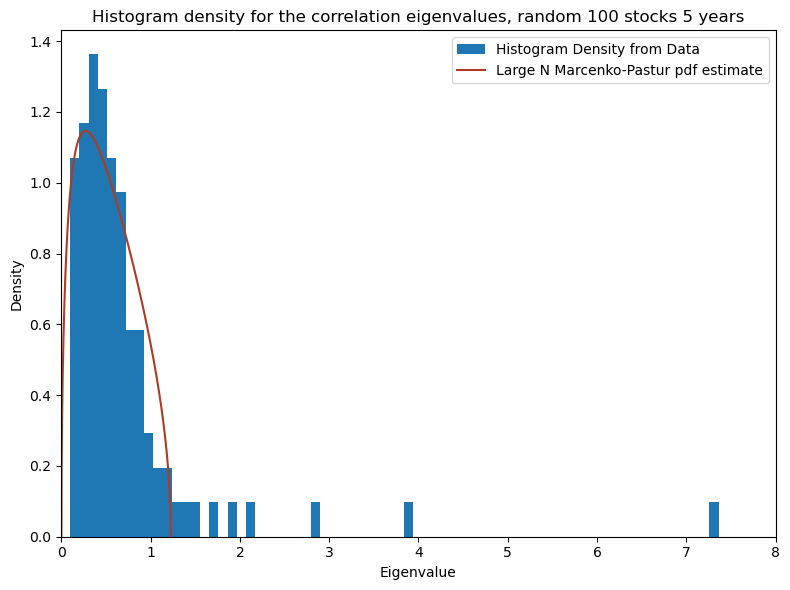

In [39]:
plt.hist(eig_list_random_100_5y,bins=70,density=True,label='Histogram Density from Data')
plt.plot(x,y,color='#AE3B24', label='Large N Marcenko-Pastur pdf estimate')
plt.xlim([0,8])
plt.title('Histogram density for the correlation eigenvalues, random 100 stocks 5 years')
plt.xlabel('Eigenvalue')
plt.ylabel('Density')
plt.tight_layout()
plt.legend()
plt.savefig('figures/Hist_Rnd_Eig_RMT.png')
plt.show()

We see a few eigenvalues fall outside the "random" range. There are some things to be careful about the optimization, but seems promising!

## Extra: Example of Large Random Matrices Approaching MP pdf

In [40]:
#Set here the paramaters to sample random matrices.
Tt,Nt,n_Sample=5000,1000,100

We can use the auxiliary function `sample_cor_matrix`, it generates random rectangular matrices, calculates a correlation and finds the eigenvalues for n_samples.

In [41]:
#Takes a minute
eig_rnd=sample_cor_matrix(Tt,Nt,n_Sample, sigma=1)
y,x=f_MP_pdf_plot(Tt/Nt,1,shift=False)

In [42]:
# the q parameter from the MP distribution is given by the ratio of the dimensions of the rectangular matrix
qt=Tt//Nt
sigmat=1

We can generate the plot comparing the sampled eigenvalues to the RMT prediction.

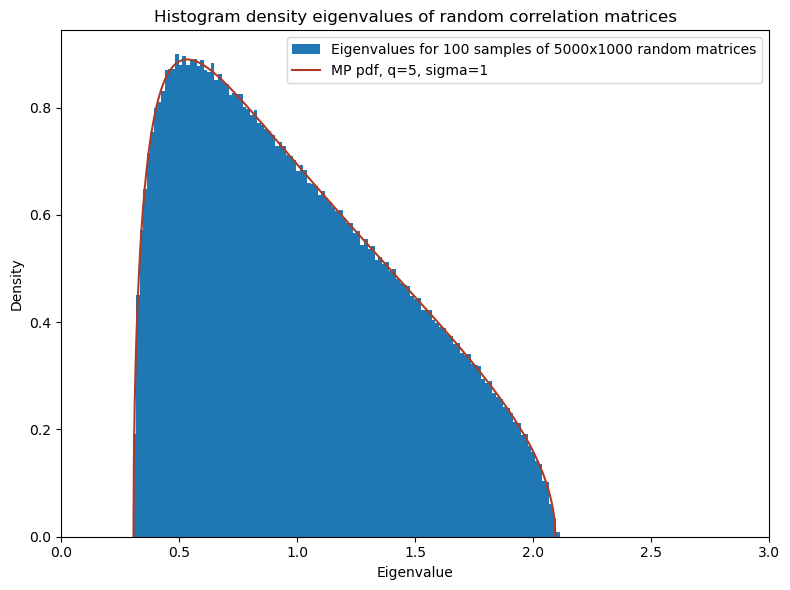

In [44]:
plt.hist(eig_rnd,bins=120,density=True,label=f'Eigenvalues for {n_Sample} samples of {Tt}x{Nt} random matrices')
plt.plot(x,y,color='#AE3B24', label=f'MP pdf, q={qt}, sigma={sigmat}')
plt.xlim([0,3])
plt.title('Histogram density eigenvalues of random correlation matrices')
plt.xlabel('Eigenvalue')
plt.ylabel('Density')
plt.tight_layout()
plt.savefig('figures/RMT_Theory_Predict.png')
plt.legend()
plt.show()